In [2]:
#basic libraries
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')
import os
os.chdir('D:/projects/earthquakes')
import geopandas as gpd
import folium
import datetime as dt

In [9]:
#leemos la base de datos 
sismos = pd.read_excel('D:/projects/earthquakes/data/sismoshist.xlsx', parse_dates=[[1,2]],)
#el segundo paso es para identificar el dataframe como geopandas
sismos = gpd.GeoDataFrame(sismos, geometry=gpd.points_from_xy(sismos.LONGITUD, sismos.LATITUD))

In [7]:
sismos.head(5)

,ID,FECHA_UTC,HORA_UTC,LATITUD,LONGITUD,PROFUNDIDAD,MAGNITUD,FECHA_CORTE,geometry
0,0,1960-01-13,154034,-16.145,-72.144,60,7.5,20223006,POINT (-72.14400 -16.14500)
1,1,1960-01-15,93024,-15.000,-75.000,70,7.0,20223006,POINT (-75.00000 -15.00000)
2,2,1960-01-17,25758,-14.500,-74.500,150,6.4,20223006,POINT (-74.50000 -14.50000)
3,3,1960-01-23,33732,-12.500,-68.500,300,5.8,20223006,POINT (-68.50000 -12.50000)
4,4,1960-01-30,50724,-5.500,-77.500,100,5.7,20223006,POINT (-77.50000 -5.50000)


In [10]:
sismos['FECHA'] = sismos['FECHA_UTC_HORA_UTC'].dt.strftime("%d/%m/%Y")
sismos['HORA'] = sismos['FECHA_UTC_HORA_UTC'].dt.strftime("%H:%M:%S")
sismos['AÑO'] = sismos['FECHA_UTC_HORA_UTC'].dt.strftime("%Y")
sismos['MES'] = sismos['FECHA_UTC_HORA_UTC'].dt.strftime("%m")
sismos['DIA'] = sismos['FECHA_UTC_HORA_UTC'].dt.strftime("%d")

In [11]:
sismos.head(5)
sismos.drop(['FECHA_UTC_HORA_UTC','FECHA_CORTE'], axis=1, inplace=True)

In [13]:
sismos

,ID,LATITUD,LONGITUD,PROFUNDIDAD,MAGNITUD,geometry,FECHA,HORA,AÑO,MES,DIA
0,0,-16.1450,-72.1440,60,7.5,POINT (-72.14400 -16.14500),13/01/1960,15:40:34,1960,01,13
1,1,-15.0000,-75.0000,70,7.0,POINT (-75.00000 -15.00000),15/01/1960,09:30:24,1960,01,15
2,2,-14.5000,-74.5000,150,6.4,POINT (-74.50000 -14.50000),17/01/1960,02:57:58,1960,01,17
3,3,-12.5000,-68.5000,300,5.8,POINT (-68.50000 -12.50000),23/01/1960,03:37:32,1960,01,23
4,4,-5.5000,-77.5000,100,5.7,POINT (-77.50000 -5.50000),30/01/1960,05:07:24,1960,01,30
...,...,...,...,...,...,...,...,...,...,...,...
22707,22707,-12.6706,-76.9744,33,3.7,POINT (-76.97440 -12.67060),31/12/2021,15:04:17,2021,12,31
22708,22708,-8.0493,-74.4580,140,4.6,POINT (-74.45800 -8.04930),31/12/2021,15:35:29,2021,12,31
22709,22709,-14.9097,-75.3355,42,3.9,POINT (-75.33550 -14.90970),31/12/2021,16:56:08,2021,12,31
22710,22710,-5.5762,-76.3891,127,4.5,POINT (-76.38910 -5.57620),31/12/2021,17:17:59,2021,12,31


una vez seleccionadas las variables que usaremos y formatear correctamente las variables procederemos a filtrar

In [114]:
sismos.head()

,ID,LATITUD,LONGITUD,PROFUNDIDAD,MAGNITUD,geometry,FECHA,HORA,AÑO,MES,DIA
0,0,-16.145,-72.144,60,7.5,POINT (-72.14400 -16.14500),13/01/1960,15:40:34,1960,01,13
1,1,-15.000,-75.000,70,7.0,POINT (-75.00000 -15.00000),15/01/1960,09:30:24,1960,01,15
2,2,-14.500,-74.500,150,6.4,POINT (-74.50000 -14.50000),17/01/1960,02:57:58,1960,01,17
3,3,-12.500,-68.500,300,5.8,POINT (-68.50000 -12.50000),23/01/1960,03:37:32,1960,01,23
4,4,-5.500,-77.500,100,5.7,POINT (-77.50000 -5.50000),30/01/1960,05:07:24,1960,01,30


más de 60 años de datos de sismos, dan un total de 22712. De esta base debemos filtrar los simos de baja magnitud que no generan daños a las estructuras. Asimismo, debemos hacer un corte cronológico. En este caso solo se considerará los sismos desde el año 2000.

In [17]:
#filtramos por YEAR
sismos = sismos[sismos['AÑO'] >= '2007']

In [18]:
sismos.shape
#nos quedan unos 14k sismos desde el year 2000 hasta 2021

(10757, 11)

procedemos a filtrar por magnitud. Segun el la magnitud un sismos puede ser perceptible o no. En cuanto al proyecto busca ver el posible peligro que puede generar a las provincias con menores recursos hospitalarios ante un sismo fuerte. Se filtrara a los sismos mayores a 4, los cuales ya son perceptibles.

In [19]:
sismos = sismos[sismos['MAGNITUD'] > 4]

In [20]:
sismos

,ID,LATITUD,LONGITUD,PROFUNDIDAD,MAGNITUD,geometry,FECHA,HORA,AÑO,MES,DIA
11955,11955,-5.8786,-77.6477,14,5.1,POINT (-77.64770 -5.87860),02/01/2007,02:00:12,2007,01,02
11956,11956,-11.3961,-79.0758,31,5.3,POINT (-79.07580 -11.39610),02/01/2007,17:43:51,2007,01,02
11957,11957,-17.6649,-70.5426,106,5.3,POINT (-70.54260 -17.66490),04/01/2007,09:27:35,2007,01,04
11958,11958,-15.9610,-73.6562,50,5.1,POINT (-73.65620 -15.96100),05/01/2007,07:24:11,2007,01,05
11959,11959,-15.6313,-72.8287,80,4.8,POINT (-72.82870 -15.63130),06/01/2007,04:20:59,2007,01,06
...,...,...,...,...,...,...,...,...,...,...,...
22699,22699,-9.2366,-79.3581,42,4.9,POINT (-79.35810 -9.23660),24/12/2021,22:10:47,2021,12,24
22700,22700,-16.5706,-72.9577,46,4.4,POINT (-72.95770 -16.57060),25/12/2021,02:25:48,2021,12,25
22702,22702,-7.9554,-75.5877,35,4.3,POINT (-75.58770 -7.95540),29/12/2021,08:12:06,2021,12,29
22708,22708,-8.0493,-74.4580,140,4.6,POINT (-74.45800 -8.04930),31/12/2021,15:35:29,2021,12,31


In [21]:
sismos['rango_alerta'] = sismos['MAGNITUD'].apply(lambda x: (x < 4.5 and 'Leve') or (x < 6 and "Moderado") or "Fuerte" )

In [22]:
sismos.to_csv('base_sismos.csv')

<AxesSubplot:xlabel='rango_alerta', ylabel='count'>

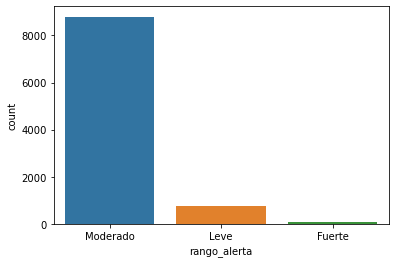

In [23]:
sns.countplot(sismos.rango_alerta)

NameError: name 'per_year' is not defined

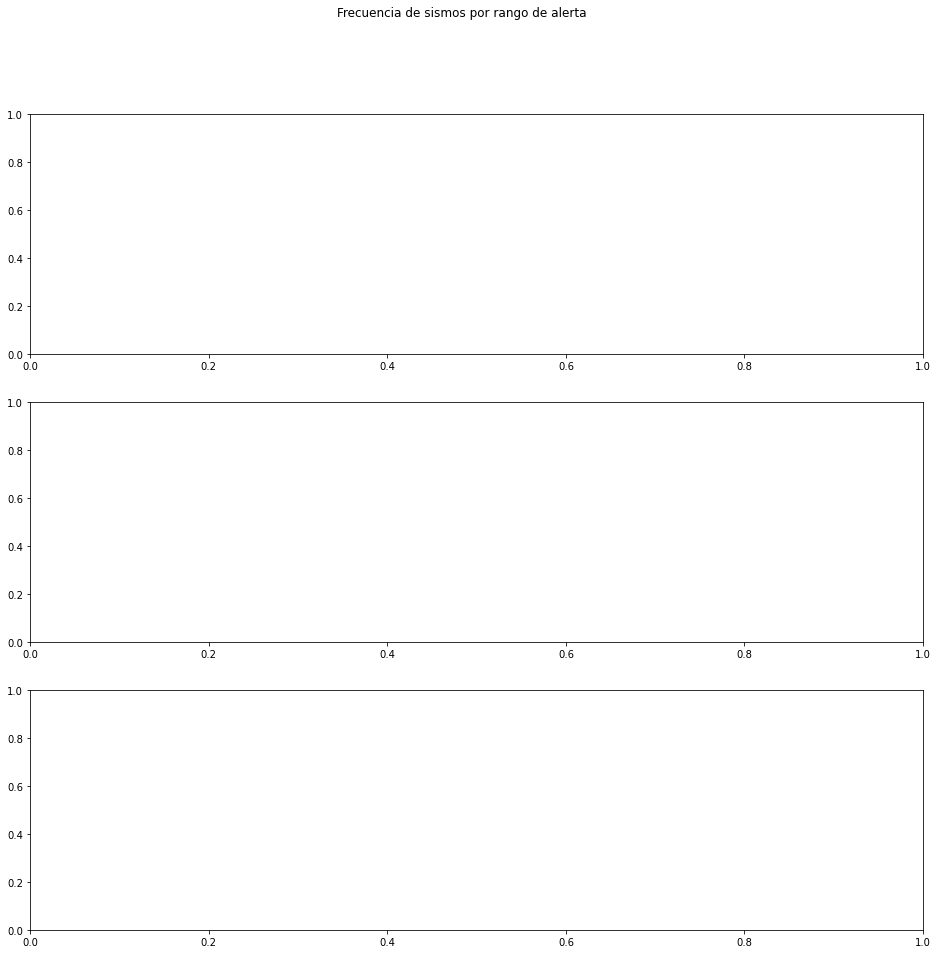

In [24]:
from turtle import color


fig, axes = plt.subplots(3,1, figsize=(16, 15), sharey=False,)
fig.suptitle('Frecuencia de sismos por rango de alerta')

# Bulbasaur
sns.lineplot(per_year[per_year.rango_alerta == 'Leve']['AÑO'], per_year[per_year.rango_alerta == 'Leve']['ID'],ax=axes[0], color = 'green')
axes[0].set_title("Leve")

# Charmander
sns.lineplot(per_year[per_year.rango_alerta == 'Moderado']['AÑO'], per_year[per_year.rango_alerta == 'Moderado']['ID'],ax=axes[1], color = "y")
axes[1].set_title("Moderado")

# Squirtle
sns.lineplot(per_year[per_year.rango_alerta == 'Fuerte']['AÑO'], per_year[per_year.rango_alerta == 'Fuerte']['ID'],ax=axes[2], color='r')

axes[2].set_title("Fuerte")

Podemos ver graficamente que la mayor cantidad de sismos tiene un rango de alerta Moderado. Asimismo, en el ultimo año hubo menor cantidad de sismos moderados y fuertes, pero primando los de rango de alerta leve. 

---

In [25]:
pob = pd.read_csv('D:/projects/earthquakes/data/pob.csv')

In [26]:
pob

,ubigeo_reniec,ubigeo_inei,Departamento,Provincia,Distrito,Edad_Anio,Sexo,Cantidad
0,21406,21910,ANCASH,SIHUAS,SICSIBAMBA,6,M,9
1,21406,21910,ANCASH,SIHUAS,SICSIBAMBA,65-69,F,23
2,21406,21910,ANCASH,SIHUAS,SICSIBAMBA,65-69,M,25
3,21406,21910,ANCASH,SIHUAS,SICSIBAMBA,60-64,F,40
4,21406,21910,ANCASH,SIHUAS,SICSIBAMBA,60-64,M,30
...,...,...,...,...,...,...,...,...
123679,21507,22007,ANCASH,YUNGAY,SHUPLUY,18,M,21
123680,21507,22007,ANCASH,YUNGAY,SHUPLUY,17,F,22
123681,21507,22007,ANCASH,YUNGAY,SHUPLUY,17,M,16
123682,21507,22007,ANCASH,YUNGAY,SHUPLUY,16,F,16


In [27]:
df = pob.groupby(['Departamento','Provincia','Distrito','ubigeo_inei'])['Cantidad'].sum().reset_index()


In [28]:
df.head(5)

,Departamento,Provincia,Distrito,ubigeo_inei,Cantidad
0,AMAZONAS,BAGUA,ARAMANGO,10202,11151
1,AMAZONAS,BAGUA,BAGUA,10201,26246
2,AMAZONAS,BAGUA,COPALLIN,10203,6394
3,AMAZONAS,BAGUA,EL PARCO,10204,1489
4,AMAZONAS,BAGUA,IMAZA,10205,24373


In [11]:
df.to_excel("Poblacion.xlsx")

In [185]:
df['UBIGEO']= df.ubigeo_inei.apply(lambda x : str(x).zfill(6))
df = df[['UBIGEO','Cantidad']]
df['UBIGEO'] = df['UBIGEO'].astype(str).astype(int)

In [182]:
prov = gpd.read_file('D:/projects/earthquakes/data/sh/LIMITE_PROVINCIA/LIMITE_PROV.shp')
dist = gpd.read_file('D:/projects/earthquakes/data/sh/LIMITE_DISTRITO/LIMITE_DIST.shp')
dep = gpd.read_file('D:/projects/earthquakes/data/sh/LIMITE_DEPARTAMENTO/LIMITE_DEP.shp')

In [183]:
dist = dist[['NOMBDEP','NOMBPROV','NOMBDIST','UBIGEO','geometry']]
dist['UBIGEO'] = dist['UBIGEO'].astype(str).astype(int)

In [186]:
data = pd.merge(dist, df, how= 'left',on = 'UBIGEO')
data.to_csv('base.csv')

In [187]:
data.sort_values(by='Cantidad', ascending=False)

,NOMBDEP,NOMBPROV,NOMBDIST,UBIGEO,geometry,Cantidad
915,LIMA,LIMA,SAN JUAN DE LURIGANCHO,150132,"MULTIPOLYGON (((-77.03065 -11.99639, -77.03056...",1160109
896,LIMA,LIMA,SAN MARTIN DE PORRES,150135,"POLYGON ((-77.08499 -11.93760, -77.08485 -11.9...",744333
888,LIMA,LIMA,ATE,150103,"POLYGON ((-76.83689 -11.99370, -76.83517 -11.9...",669808
897,LIMA,LIMA,COMAS,150110,"POLYGON ((-77.04643 -11.89743, -77.04560 -11.8...",557997
894,LIMA,LIMA,VILLA EL SALVADOR,150142,"POLYGON ((-76.93980 -12.18648, -76.93945 -12.1...",492201
...,...,...,...,...,...,...
1420,AMAZONAS,CHACHAPOYAS,SONCHE,10121,"POLYGON ((-77.86135 -6.11924, -77.86133 -6.119...",221
1439,AMAZONAS,BONGARA,RECTA,10308,"POLYGON ((-77.79211 -5.89905, -77.79180 -5.899...",207
867,LIMA,YAUYOS,HUAMPARA,151013,"POLYGON ((-76.22344 -12.29909, -76.22260 -12.2...",200
272,TACNA,CANDARAVE,CURIBAYA,230204,"POLYGON ((-70.29981 -17.33536, -70.29947 -17.3...",187


In [203]:
sismos[sismos.rango_alerta == "Fuerte"]

,ID,LATITUD,LONGITUD,PROFUNDIDAD,MAGNITUD,geometry,FECHA,HORA,AÑO,MES,DIA,rango_alerta
8761,8761,-3.6588,-81.6273,38,6.0,POINT (-81.62730 -3.65880),22/05/2000,13:15:00,2000,05,22,Fuerte
8855,8855,-17.9067,-71.9998,39,6.0,POINT (-71.99980 -17.90670),03/08/2000,19:22:09,2000,08,03,Fuerte
9009,9009,-7.9328,-74.5375,120,6.1,POINT (-74.53750 -7.93280),01/11/2000,04:27:42,2000,11,01,Fuerte
9030,9030,-8.4457,-80.3849,17,6.0,POINT (-80.38490 -8.44570),13/11/2000,06:46:06,2000,11,13,Fuerte
9252,9252,-16.2021,-73.7555,32,8.4,POINT (-73.75550 -16.20210),23/06/2001,20:33:14,2001,06,23,Fuerte
...,...,...,...,...,...,...,...,...,...,...,...,...
21820,21820,-20.5325,-69.4245,123,6.2,POINT (-69.42450 -20.53250),06/12/2020,16:47:41,2020,12,06,Fuerte
21866,21866,-16.1402,-74.4222,41,6.0,POINT (-74.42220 -16.14020),27/12/2020,07:11:09,2020,12,27,Fuerte
22241,22241,-12.7668,-77.0052,45,6.0,POINT (-77.00520 -12.76680),23/06/2021,02:54:17,2021,06,23,Fuerte
22323,22323,-4.8503,-80.8410,32,6.1,POINT (-80.84100 -4.85030),30/07/2021,17:10:18,2021,07,30,Fuerte


In [190]:
def embed_map(m, file_name):
    from IPython.display import IFrame
    m.save(file_name)
    return IFrame(file_name, width='100%', height='500px')

In [200]:
m_2 = folium.Map(location=[-11.488508, -76.614951], tiles='cartodbpositron', zoom_start=5)

# Your code here: Add a map to visualize earthquake depth
for i in range(len(plate_boundaries)):
    folium.PolyLine(locations=plate_boundaries.coordinates.iloc[i], weight=2, color='black').add_to(m_2)


def color_producer(rango_alerta):
    if rango_alerta == "Leve":
        return 'green'
    elif rango_alerta =="Moderado":
        return 'yellow'
    else:
        return 'red'
    
for i in range(0,len(sismos)):
    folium.Circle(
    location=[sismos.iloc[i]['LATITUD'], sismos.iloc[i]['LONGITUD']], radius = 2000, color = color_producer(sismos.iloc[i]['MAGNITUD'])).add_to(m_2)


for i in range(0,len(sismos)):
    folium.Circle(
        location=[sismos.iloc[i]['LATITUD'], sismos.iloc[i]['LONGITUD']],
        radius=sismos.iloc[i]['MAGNITUD']**5.5,
        color=color_producer(sismos.iloc[i]['rango_alerta'])).add_to(m_2)
# View the map
for _, r in dep.iterrows():
    # Without simplifying the representation of each borough,
    # the map might not be displayed
    sim_geo = gpd.GeoSeries(r['geometry']).simplify(tolerance=0.001)
    geo_j = sim_geo.to_json()
    geo_j = folium.GeoJson(data=geo_j,
                           style_function=lambda x: {'fillColor': 'none'})
    folium.Popup(r['NOMBDEP']).add_to(geo_j)
    geo_j.add_to(m_2)


embed_map(m_2, 'q_1.html')
m_2



In [196]:
plate_boundaries = gpd.read_file("D:/projects/earthquakes/data/placas/placas.shp")
plate_boundaries['coordinates'] = plate_boundaries.apply(lambda x: [(b,a) for (a,b) in list(x.geometry.coords)], axis='columns')
plate_boundaries.drop('geometry', axis=1, inplace=True)

plate_boundaries.head()


,HAZ_PLATES,HAZ_PLAT_1,HAZ_PLAT_2,Shape_Leng,coordinates
0,TRENCH,SERAM TROUGH (ACTIVE),6722,5.843467,"[(-5.444200361999947, 133.6808931800001), (-5...."
1,TRENCH,WETAR THRUST,6722,1.829013,"[(-7.760600482999962, 125.47879802900002), (-7..."
2,TRENCH,TRENCH WEST OF LUZON (MANILA TRENCH) NORTHERN ...,6621,6.743604,"[(19.817899819000047, 120.09999798800004), (19..."
3,TRENCH,BONIN TRENCH,9821,8.329381,"[(26.175899215000072, 143.20620700100005), (26..."
4,TRENCH,NEW GUINEA TRENCH,8001,11.998145,"[(0.41880004000006466, 132.8273013480001), (0...."


In [198]:
# Create a base map with plate boundaries
m_1 = folium.Map(location=[-11.488508, -76.614951], tiles='cartodbpositron', zoom_start=5)
for i in range(len(plate_boundaries)):
    folium.PolyLine(locations=plate_boundaries.coordinates.iloc[i], weight=2, color='black').add_to(m_1)

# Your code here: Add a heatmap to the map



# Uncomment to see a hint
#q_1.a.hint()

# Show the map
m_1